In [1]:
import pandas as pd
import plotly.express as px
import fish
import lca
import survey
import fooddb

In [2]:
jp_lca_df = lca.load()
fish_env_info_df, fish_weighting_df, fish_matching_df = fish.load()
products_df, categories_df = fooddb.load()
survey_df = survey.load()

In [3]:
products_df, categories_df, ingredients_df = fooddb.clean(products_df, categories_df)

energy_per_100 520kj -> ['kj'] (1000.0), 520.0
energy_per_100 1662kj -> ['kj'] (1000.0), 1662.0
energy_per_100 1123kj/ -> ['kj'] (1000.0), 1123.0
energy_per_100 416 kj -> ['kj'] (1000.0), 416.0
energy_per_100 222kj -> ['kj'] (1000.0), 222.0
energy_per_100 932 kj -> ['kj'] (1000.0), 932.0
energy_per_100 1270 kj -> ['kj'] (1000.0), 1270.0
energy_per_100 1264kj/ -> ['kj'] (1000.0), 1264.0
energy_per_100 547kj -> ['kj'] (1000.0), 547.0
energy_per_100 234kj -> ['kj'] (1000.0), 234.0
energy_per_100 182 kj -> ['kj'] (1000.0), 182.0
energy_per_100 1219 kj -> ['kj'] (1000.0), 1219.0
energy_per_100 444kj -> ['kj'] (1000.0), 444.0
energy_per_100 1118kj -> ['kj'] (1000.0), 1118.0
energy_per_100 715kj -> ['kj'] (1000.0), 715.0
energy_per_100 870 kj -> ['kj'] (1000.0), 870.0
energy_per_100 871kj -> ['kj'] (1000.0), 871.0
energy_per_100 245 kj -> ['kj'] (1000.0), 245.0
energy_per_100 262kj -> ['kj'] (1000.0), 262.0
energy_per_100 1183 kj -> ['kj'] (1000.0), 1183.0
energy_per_100 1018 kj -> ['kj'] (10

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [30]:
survey_df

,mc_run_id,grouping,mean_ghgs,mean_land,mean_watscar,mean_eut,mean_ghgs_ch4,mean_ghgs_n2o,mean_bio,mean_watuse,...,sd_eut,sd_ghgs_ch4,sd_ghgs_n2o,sd_bio,sd_watuse,sd_acid,n_participants,sex,diet_group,age_group
0,1,fish_female_20-29,5.421821,8.612772,14165.86240,23.945372,1.164643,0.343663,476.270413,679.923479,...,8.167013,0.632547,0.146827,283.883428,249.472563,8.231176,1329,female,fish,20-29
1,1,fish_female_30-39,5.436673,8.680248,15222.77063,24.305262,1.154118,0.326868,467.923201,709.343785,...,8.467858,0.601941,0.130298,270.247108,277.927269,7.947014,2024,female,fish,30-39
2,1,fish_female_40-49,5.289333,8.467723,15818.80068,24.191105,1.108404,0.310324,438.659832,707.925368,...,8.107006,0.572941,0.119872,252.415063,275.760515,8.103589,1689,female,fish,40-49
3,1,fish_female_50-59,5.169020,8.219199,16962.06009,24.748154,1.032501,0.298130,395.787622,720.825105,...,9.514028,0.509689,0.104731,209.566722,310.422445,8.712428,946,female,fish,50-59
4,1,fish_female_60-69,5.380268,8.570718,18212.66232,25.559430,1.098828,0.310735,421.176867,749.392826,...,9.258068,0.609398,0.113401,264.599257,315.922570,8.616601,492,female,fish,60-69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71995,1000,veggie_male_30-39,6.615301,11.385959,13374.38105,18.283800,1.769398,0.482313,641.918305,560.925069,...,6.829520,1.524615,0.269856,610.318478,268.939576,8.510504,1221,male,veggie,30-39
71996,1000,veggie_male_40-49,6.185949,10.566347,12959.68443,17.342092,1.605406,0.446074,580.913591,527.860144,...,6.369390,1.430116,0.252651,570.034533,262.366892,7.988943,961,male,veggie,40-49
71997,1000,veggie_male_50-59,5.871454,9.806539,11924.19092,16.625511,1.468003,0.431966,533.784777,487.176818,...,6.266982,1.381163,0.274705,559.427383,241.645519,7.780208,426,male,veggie,50-59
71998,1000,veggie_male_60-69,5.922496,9.873027,11310.87733,16.531075,1.492114,0.437879,545.453273,487.030916,...,6.240777,1.435583,0.276000,582.000324,244.768887,7.779582,229,male,veggie,60-69


In [127]:
diet_info = pd.DataFrame({
    'diet_group': ['vegan','vegetarian','fish','meat50','meat','meat100'],
    'rank': [1,2,3,4,5,6],
    'color': ['#FF7E96','#E9677F','#C25252','#7AFF93','#1DB887','#3988C4'],
    'label': ['Vegan','Vegetarian','Fish Eaters','Low Meat Maters','Medium Meat Eaters','High Meat Eaters']
})
diet_info

,diet_group,rank,color,label
0,vegan,1,#FF7E96,Vegan
1,vegetarian,2,#E9677F,Vegetarian
2,fish,3,#C25252,Fish Eaters
3,meat50,4,#7AFF93,Low Meat Maters
4,meat,5,#1DB887,Medium Meat Eaters
5,meat100,6,#3988C4,High Meat Eaters


In [130]:
total_participants = survey_df['n_participants'].sum()
survey_df['weighted_mean_ghgs'] = survey_df['mean_ghgs'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_land'] = survey_df['mean_land'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_watscar'] = survey_df['mean_watscar'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_eut'] = survey_df['mean_eut'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_ghgs_ch4'] = survey_df['mean_ghgs_ch4'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_watuse'] = survey_df['mean_watuse'] #* survey_df['n_participants'] / total_participants

survey_df['weighted_mean_ghgs'] = survey_df['weighted_mean_ghgs'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_land'] = survey_df['weighted_mean_land'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_watscar'] = survey_df['weighted_mean_watscar'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_eut'] = survey_df['weighted_mean_eut'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_ghgs_ch4'] = survey_df['weighted_mean_ghgs_ch4'] #* survey_df['n_participants'] / total_participants
survey_df['weighted_mean_watuse'] = survey_df['weighted_mean_watuse'] #* survey_df['n_participants'] / total_participants
#df = survey_df.groupby('diet_group').agg({
#    'weighted_mean_ghgs': 'sum',
#    'weighted_mean_land': 'sum',
#    'weighted_mean_watscar': 'sum',
#    'weighted_mean_eut': 'sum',
#    'weighted_mean_ghgs_ch4': 'sum',
#    'weighted_mean_watuse': 'sum'
#})
#
#df = df.reset_index()
#df = pd.merge(df, diet_info, on='diet_group')
#df['diet_color'] = df['diet_group'].map(diet_info.set_index('diet')['color'])
#df['diet_label'] = df['diet_group'].map(diet_info.set_index('diet')['label'])
#df = df.reindex(diet_info['diet'])
survey_df

,mc_run_id,grouping,mean_ghgs,mean_land,mean_watscar,mean_eut,mean_ghgs_ch4,mean_ghgs_n2o,mean_bio,mean_watuse,...,weigthed_mean_watuse,weighted_mean_ghgs,weighted_mean_land,weighted_mean_watscar,weighted_mean_eut,weighted_mean_lghgs_ch4,weighted_mean_watuse,weighted_mean_ghgs_ch4,diet_color,diet_label
0,1,fish_female_20-29,5.421821,8.612772,14165.86240,23.945372,1.164643,0.343663,476.270413,679.923479,...,679.923479,5.421821,8.612772,14165.86240,23.945372,1.164643,679.923479,1.164643,"2 #C25252 Name: color, dtype: object","2 Fish Eaters Name: label, dtype: object"
1,1,fish_female_30-39,5.436673,8.680248,15222.77063,24.305262,1.154118,0.326868,467.923201,709.343785,...,709.343785,5.436673,8.680248,15222.77063,24.305262,1.154118,709.343785,1.154118,"2 #C25252 Name: color, dtype: object","2 Fish Eaters Name: label, dtype: object"
2,1,fish_female_40-49,5.289333,8.467723,15818.80068,24.191105,1.108404,0.310324,438.659832,707.925368,...,707.925368,5.289333,8.467723,15818.80068,24.191105,1.108404,707.925368,1.108404,"2 #C25252 Name: color, dtype: object","2 Fish Eaters Name: label, dtype: object"
3,1,fish_female_50-59,5.169020,8.219199,16962.06009,24.748154,1.032501,0.298130,395.787622,720.825105,...,720.825105,5.169020,8.219199,16962.06009,24.748154,1.032501,720.825105,1.032501,"2 #C25252 Name: color, dtype: object","2 Fish Eaters Name: label, dtype: object"
4,1,fish_female_60-69,5.380268,8.570718,18212.66232,25.559430,1.098828,0.310735,421.176867,749.392826,...,749.392826,5.380268,8.570718,18212.66232,25.559430,1.098828,749.392826,1.098828,"2 #C25252 Name: color, dtype: object","2 Fish Eaters Name: label, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71995,1000,veggie_male_30-39,6.615301,11.385959,13374.38105,18.283800,1.769398,0.482313,641.918305,560.925069,...,560.925069,6.615301,11.385959,13374.38105,18.283800,1.769398,560.925069,1.769398,"Series([], Name: color, dtype: object)","Series([], Name: label, dtype: object)"
71996,1000,veggie_male_40-49,6.185949,10.566347,12959.68443,17.342092,1.605406,0.446074,580.913591,527.860144,...,527.860144,6.185949,10.566347,12959.68443,17.342092,1.605406,527.860144,1.605406,"Series([], Name: color, dtype: object)","Series([], Name: label, dtype: object)"
71997,1000,veggie_male_50-59,5.871454,9.806539,11924.19092,16.625511,1.468003,0.431966,533.784777,487.176818,...,487.176818,5.871454,9.806539,11924.19092,16.625511,1.468003,487.176818,1.468003,"Series([], Name: color, dtype: object)","Series([], Name: label, dtype: object)"
71998,1000,veggie_male_60-69,5.922496,9.873027,11310.87733,16.531075,1.492114,0.437879,545.453273,487.030916,...,487.030916,5.922496,9.873027,11310.87733,16.531075,1.492114,487.030916,1.492114,"Series([], Name: color, dtype: object)","Series([], Name: label, dtype: object)"


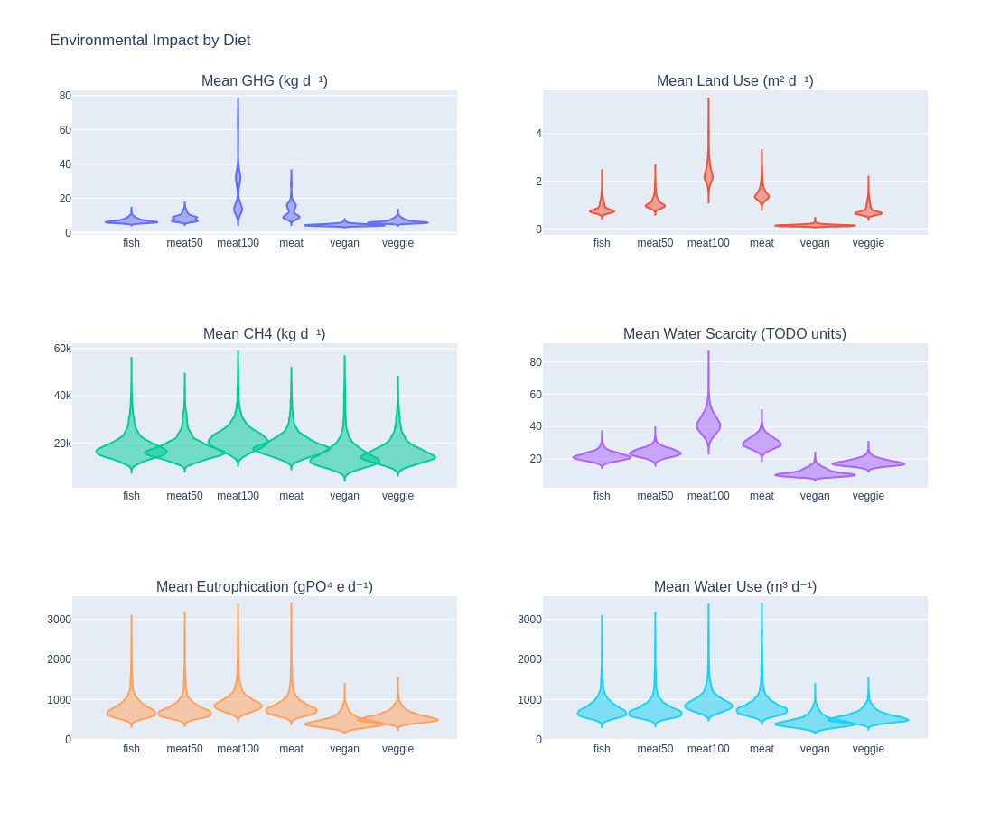

In [129]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

#fig1 = px.box(survey_df, x='diet_group', y='mean_ghgs')
#fig1 = go.Box(x=survey_df['diet_group'], y=survey_df['mean_ghgs'])
 


#grid = go.Figure()
#(rows=1, cols=2, subplot_titles=("mean GHG", "Mean Land Use"))

subcharts = [[('weighted_mean_land', "Mean GHG (kg d⁻¹)"), ('weighted_mean_ghgs_ch4', "Mean Land Use (m² d⁻¹)")],
            [('weighted_mean_watscar', "Mean CH4 (kg d⁻¹)"), ('weighted_mean_eut', "Mean Water Scarcity (TODO units)")],
            [('weighted_mean_watuse', "Mean Eutrophication (gPO⁴ e d⁻¹)"), ('weighted_mean_watuse', "Mean Water Use (m³ d⁻¹)")]]

titles_joined = [title for row in subcharts for (key, title) in row]

# Citing https://doi.org/10.1038/s43016-023-00795-w -- TODO
grid = make_subplots(row_heights=[600]*3, rows=3, cols=2,
                     subplot_titles=titles_joined,
                     shared_xaxes='rows')
grid.update_layout(title_text='Environmental Impact by Diet',height=900)

for row in range(3):
    for col in range(2):
        fig = go.Figure()
        for val, color in zip(survey_df['diet_group'], survey_df['
        grid.add_trace(
            go.Violin(x=survey_df['diet_group'], y=survey_df[subcharts[row][col][0]],
                      points=False, width=1.5), col=col+1, row=row+1)

grid.update_layout(showlegend=False)

#grid.add_trace(
#    go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_ghgs'],
#              points=False, width=1.5,
#              category_orders={'class': diet_info['diet']}), col=1, row=1, xaxis=dict())
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weigthed_mean_land'], points=False, width=1.5), col=2, row=1)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_ghgs_ch4'], points=False, width=1.5), col=1, row=2)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_watscar'], points=False, width=1.5), col=2, row=2)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_eut'], points=False, width=1.5), col=1, row=3)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_watuse'], points=False, width=1.5), col=2, row=3)

grid.show()

In [87]:
cols = [
    'weighted_mean_ghgs',
    'weighted_mean_land',
    'weighted_mean_watscar',
    'weighted_mean_eut',
    'weighted_mean_ghgs_ch4',
    'weighted_mean_watuse'
]

subcharts = [[('weighted_mean_land', "Mean GHG (kg d⁻¹)"), ('weighted_mean_ghgs_ch4', "Mean Land Use (m² d⁻¹)")],
            [('weighted_mean_watscar', "Mean CH4 (kg d⁻¹)"), ('weighted_mean_eut', "Mean Water Scarcity (TODO units)")],
            [('weighted_mean_watuse', "Mean Eutrophication (gPO⁴ e d⁻¹)"), ('weighted_mean_watuse', "Mean Water Use (m³ d⁻¹)")]]

titles_joined = [title for row in subcharts for (key, title) in row]

# Citing https://doi.org/10.1038/s43016-023-00795-w -- TODO
grid = make_subplots(row_heights=[600]*3, rows=3, cols=2,
                     subplot_titles=titles_joined,
                     shared_xaxes='rows')
grid.update_layout(title_text='Environmental Impact by Diet',height=900)

for row in range(3):
    for col in range(2):
        grid.add_trace(
            go.Violin(x=survey_df['diet_group'], y=survey_df[subcharts[row][col][0]],
                      points=False, width=1.5), col=col+1, row=row+1)

#grid.add_trace(
#    go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_ghgs'],
#              points=False, width=1.5,
#              category_orders={'class': diet_info['diet']}), col=1, row=1, xaxis=dict())
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weigthed_mean_land'], points=False, width=1.5), col=2, row=1)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_ghgs_ch4'], points=False, width=1.5), col=1, row=2)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_watscar'], points=False, width=1.5), col=2, row=2)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_eut'], points=False, width=1.5), col=1, row=3)
#grid.add_trace(go.Violin(x=survey_df['diet_group'], y=survey_df['weighted_mean_watuse'], points=False, width=1.5), col=2, row=3)

grid.show()

fig = go.Scatterpolar(name='Total', r=df[cols], theta=cols)
